## Analysis AirBnb listings in New York

by Julie Olin, Mik Lokdam and Julian Roin Skovhus

### Preface
This is the detailed notebook including all the code, analysis, results and related discussion done in this project. For a short, visual presentation, visit the [website](https://julieolin.github.io/week8/).

#### Preamble

In [1]:
## Basics
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import io
from PIL import Image
import seaborn as sns
import json
import branca.colormap as cm
import geopandas as gpd
import warnings

## Interactive maps
from bokeh.io import output_notebook
from bokeh.layouts import row
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, ranges, Legend
from bokeh.palettes import Category20
from folium.plugins import HeatMap
output_notebook()
import math
import folium

## Modelling
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RandomizedSearchCV

warnings.filterwarnings('ignore')
colors = sns.color_palette("plasma")

Loading BokehJS ...

### 1. Motivation

In this project our study area is confined to New York, the Big Apple, the City that Never Sleeps. By looking at the 4 different datasets (summarized in the table below), we wish to create an interactive guide that can help tourists to choose where to stay depending on their needs and wants. 

Besides information on the AirbBnb listings, we also include information on crime, noise complaints and cafes/restaurants. One could include many other data sets to describe a city, but we considered these to be key contributors to the niceness of a neighborhood. Additionally, the included data set needed to have spatial dimensions, which limited the amount of useable data sets significantly. 

With over AirBnB 45000+ listings in New York in 2016, there are plenty of places to choose from and given the fact that there are more than 19 mio. residents in a fairly small area, the diversity is high and districts have their own 'spark'. To help tourists in choosing the right district without having to read a myriad of blogs, we have created this visual guide based on explorative and explanative data analysis.

| Name | Used features | Size | Year | Source |
| --- | --- | --- | --- | --- |
|AirBnb | Id, lat, lon, price, availability, neighborhood, reviews, hosts etc. | 7MB | 2019 | Kaggle
|Crime data  | Id, lat, lon | 1.7GB | 2017-18 | Kaggle
|Noise complaints| Id, lat, lon | 53MB | 2016 | Kaggle
|Restaurants| Id, lat, lon | 139MB | 2018 | Kaggle

We'll briefly explain the attributes in the AirBnb data set as this is essential to understand the following analysis

* **id** (*integer*): unique id for the Airbnb listing
* **name** (*string*): title of the Airbnb listing
* **host_id** (*integer*): unique id for the host
* **host_name** (*string*): name of the host
* **neighbourhood_group** (*string*): borough of the listing
* **neighbourhood** (*stringt*): neighbourhood of the listing
* **latitude** (*float*): latitude coordinates
* **longitude** (*float*): longitude coordinates
* **room_type** (*string*): type of listing
* **price** (*integer*): price of listing pr. night
* **number_of_reviews** (*integer*): number of reviews of listing
* **last_review** (*date*): date of last reviews
* **review_per_months** (*float*): average no. of reviews pr. month
* **calculated_host_listings** (*integer*): amount of listings pr. host
* **availability_365** (*integer*): number of days when listing is available for booking



### 2. Basic stats (explorative analysis)

In this section we will perform an exploratory data analysis of the AirBnb data set. We will mainly focus on investigating price, location and hosts. Towards the end, we will introduce the other data sets.

For now, we will only load the AirBnb data set and an shp-file including the districts of Manhattan. 

In [2]:
df_bnb = pd.read_csv('Air_bnb/AB_NYC_2019.csv')
fname = 'manhat_last.shp'
nil = gpd.read_file(fname)

#### 2a) Preprocessing and data cleansing

Let's start by inspecting the first few rows of the data set.

In [3]:
df_bnb.head(10)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129
6,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68688,-73.95596,Private room,60,45,49,2017-10-05,0.40,1,0
7,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Hell's Kitchen,40.76489,-73.98493,Private room,79,2,430,2019-06-24,3.47,1,220
8,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.80178,-73.96723,Private room,79,2,118,2017-07-21,0.99,1,0
9,5238,Cute & Cozy Lower East Side 1 bdrm,7549,Ben,Manhattan,Chinatown,40.71344,-73.99037,Entire home/apt,150,1,160,2019-06-09,1.33,4,188


We can see that if no reviews of a listing have been given the attributes 'last_review' and 'review_per_month' are set to NaN. We will simply set them to zero instead.  

In [4]:
df_bnb.fillna({'reviews_per_month':0}, inplace=True)
df_bnb.fillna({'last_review':0}, inplace=True)

Lets try to identify other nan values within the data.

In [5]:
df_bnb.isna().sum()

id                                 0
name                              16
host_id                            0
host_name                         21
neighbourhood_group                0
neighbourhood                      0
latitude                           0
longitude                          0
room_type                          0
price                              0
minimum_nights                     0
number_of_reviews                  0
last_review                        0
reviews_per_month                  0
calculated_host_listings_count     0
availability_365                   0
dtype: int64

We see that it is only the name of AirBnb listing and the name which are missing. None are essential for our analysis, so we will keep them as nans. 

#### 2b) Dataset stats

Initially, we look at the five large boroughs of New York. Lets see how the AirBnbs are distributed across the boroughs.

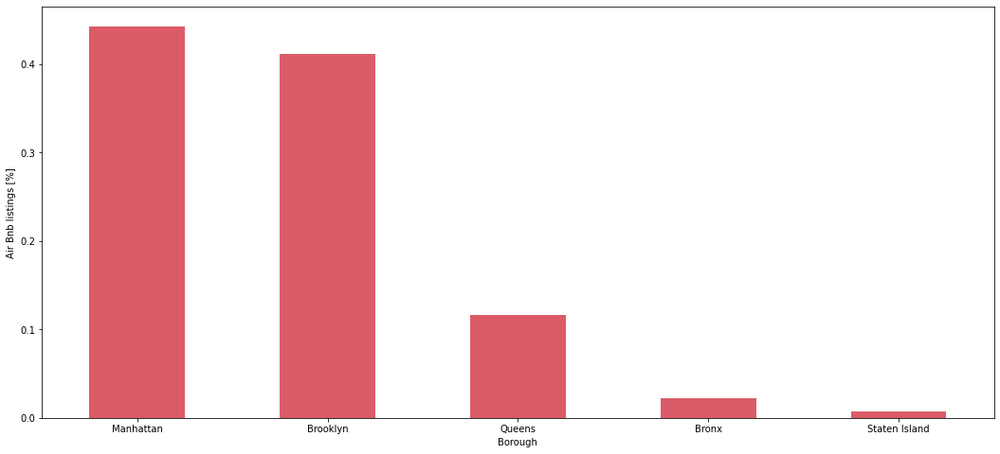

In [6]:
## Amount across boroughs
df_borough_count = df_bnb.groupby('neighbourhood_group').count()
df_borough_count['id'] = df_borough_count['id']/len(df_bnb)
fig, ax = plt.subplots(figsize=(18,8))
(df_borough_count.sort_values(by = 'id', ascending = False))['id'].plot(kind = 'bar', ax = ax, rot = 0, color=colors[3])
ax.set_xlabel('Borough')
ax.set_ylabel('Air Bnb listings [%]')
plt.show()

Majority of listings are in Manhattan and Brooklyn. Let us take a quick loot at the price distributions across the boroughs. To this end, we will use a violin plot which is very similar to a boxplot. However, as the violin plot also includes a probability density at different prices. This helps us identify the several peaks in prices that we expect.

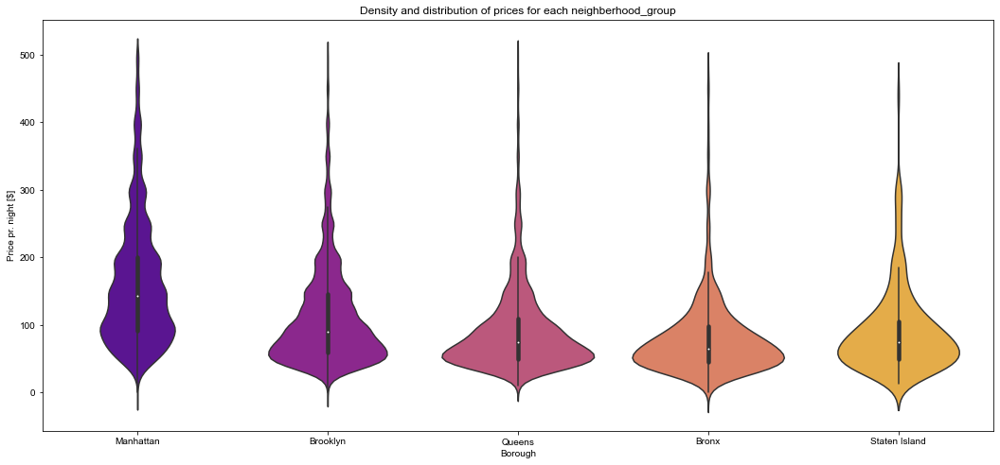

In [7]:
## Price across boroughs
fig, ax = plt.subplots(figsize=(18, 8))
sns.set_theme(style="whitegrid")
v2=sns.violinplot(ax = ax, data=df_bnb[df_bnb['price']<500], x='neighbourhood_group', y='price', 
                  palette = 'plasma', order=[ "Manhattan", "Brooklyn", "Queens", 'Bronx', 'Staten Island'])
v2.set_title('Density and distribution of prices for each neighberhood_group')
ax.set(xlabel='Borough', ylabel='Price pr. night [$]')
plt.show()

It appears that Manhattan has a higher median price of around 75\\$ than the other five boroughs. This was expected as Manhattan is centrally located and known for it is expensive housing prices which would affect the rental price as well. For Brooklyn and Manhattan we can identify the small bulges as integer prices (100\\$, 150\\$, 200\\$ etc.). We have only considered the rentals below 500\\$ as there are extreme expensive rentals, which would make the figure hard to read.

We focus the remainder of the analysis on Manhattan. This is because it is the most famous borough in New York and we want the analysis to help people who want the real New York-experience. It will also help us do more detailed analysis on specific neighborhoods. The downside is of course loss of data, but we still have around 22.000 rows.  

Let us consider the distribution of Airbnbns acorss the neighborhoods in Manhattan

In [8]:
## Basic stats
df_manhattan = df_bnb[df_bnb['neighbourhood_group'] == 'Manhattan']
df_manhattan_count = df_manhattan.groupby('neighbourhood').count()

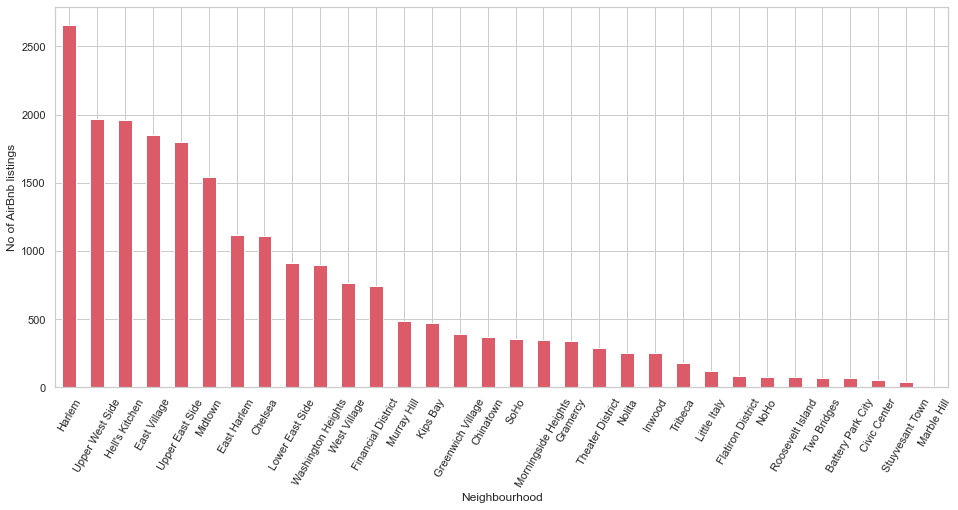

In [9]:
fig, ax = plt.subplots(figsize=(16,7))
(df_manhattan_count.sort_values(by = 'id', ascending = False))['id'].plot(kind = 'bar', ax = ax, rot = 60, color = colors[3])
ax.set(xlabel='Neighbourhood', ylabel='No of AirBnb listings')
plt.show()

Harlem has by the most listings followed by Upper West Side and Hell's Kitchen. It appears that Stuyvesant Town and Marble Hill have no listings. However, they do have 37 and 12 respectively. 

Lets take a look at the price distribution across all neighbourhoods

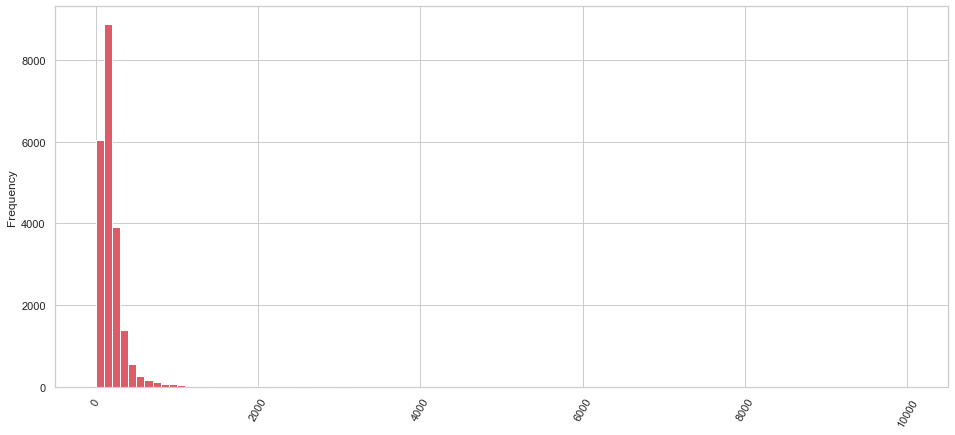

In [10]:
fig, ax = plt.subplots(figsize=(16,7))
(df_manhattan['price'].plot(kind = 'hist', ax = ax, rot = 60, color = colors[3], bins = 100))
plt.show()

It appears that the histogram is "drawn out" by high prices at around 10000$ pr. night! Lets inspect the most expensive AirBnb listings in Manhattan.

In [11]:
df_manhattan[df_manhattan['price']>5000]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
3537,2110145,UWS 1BR w/backyard + block from CP,2151325,Jay And Liz,Manhattan,Upper West Side,40.77782,-73.97848,Entire home/apt,6000,14,17,2015-02-17,0.27,1,359
3720,2243699,"SuperBowl Penthouse Loft 3,000 sqft",1483320,Omri,Manhattan,Little Italy,40.71895,-73.99793,Entire home/apt,5250,1,0,0,0.00,1,0
6530,4737930,Spanish Harlem Apt,1235070,Olson,Manhattan,East Harlem,40.79264,-73.93898,Entire home/apt,9999,5,1,2015-01-02,0.02,1,0
12342,9528920,"Quiet, Clean, Lit @ LES & Chinatown",3906464,Amy,Manhattan,Lower East Side,40.71355,-73.98507,Private room,9999,99,6,2016-01-01,0.14,1,83
15560,12520066,Luxury townhouse Greenwich Village,66240032,Linda,Manhattan,Greenwich Village,40.73046,-73.99562,Entire home/apt,6000,1,0,0,0.00,1,0
29238,22436899,1-BR Lincoln Center,72390391,Jelena,Manhattan,Upper West Side,40.77213,-73.98665,Entire home/apt,10000,30,0,0,0.00,1,83
29662,22779726,East 72nd Townhouse by (Hidden by Airbnb),156158778,Sally,Manhattan,Upper East Side,40.76824,-73.95989,Entire home/apt,7703,1,0,0,0.00,12,146
29664,22780103,Park Avenue Mansion by (Hidden by Airbnb),156158778,Sally,Manhattan,Upper East Side,40.78517,-73.95270,Entire home/apt,6419,1,0,0,0.00,12,45
30268,23377410,Beautiful/Spacious 1 bed luxury flat-TriBeCa/Soho,18128455,Rum,Manhattan,Tribeca,40.72197,-74.00633,Entire home/apt,8500,30,2,2018-09-18,0.18,1,251
37194,29547314,Apartment New York \nHell’s Kitchens,35303743,Patricia,Manhattan,Upper West Side,40.76835,-73.98367,Private room,6500,30,0,0,0.00,1,97


Words as luxury, spacious, yacht, penthouse and >3000sq.ft all appear in the name of the apartments which maybe justifies the astronomical prices. The private rooms in Lower East Side and Upper West Side and aparatmens with a price pr. night of 9999\\$ are almost certainly mistakes by the host, but we cannot know for sure. Hence we will keep them in the data set. Although the most expensive apartments are interesting, we get more information from the histogram by investigating apartments below a threshold as for the violin plots earlier.

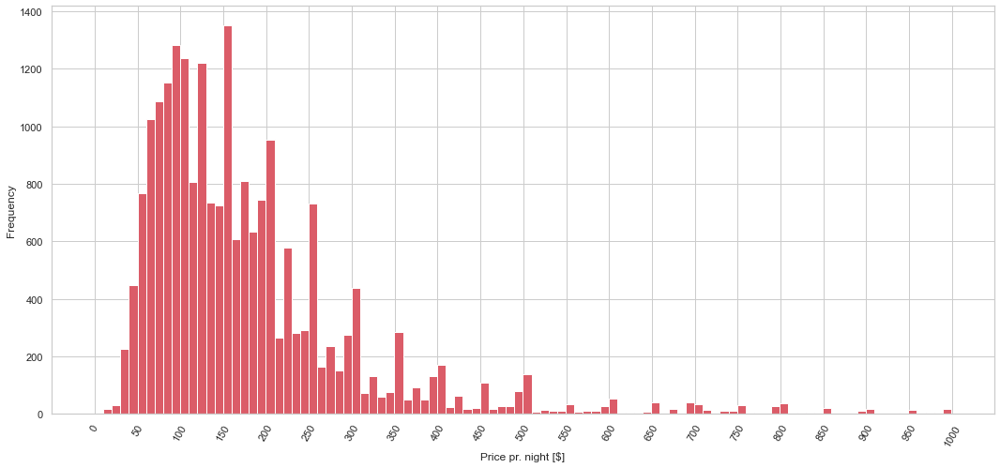

In [12]:
fig, ax = plt.subplots(figsize=(18,8))
(df_manhattan[df_manhattan['price']<1000]['price'].plot(kind = 'hist', ax = ax, rot = 60, color = colors[3], bins = 100))
ax.set_xticks(np.arange(0,1001,50))
ax.set_xlabel('Price pr. night [$]')
plt.show()

We see that the shape looks to be a right skewed normal distribution with most listings with a price of 150\\$ pr. night. When looking at mean price pr. night across neighborhoods, we look at rentals below 1000\\$ pr. night. The reason for this is that 1) the few, very expensive apartments scew the prices, especially in the neighborhoods with few listings 2) this an analysis for the people, not the filthy rich. The downside is loss of data, but it is only around 172 listings. 

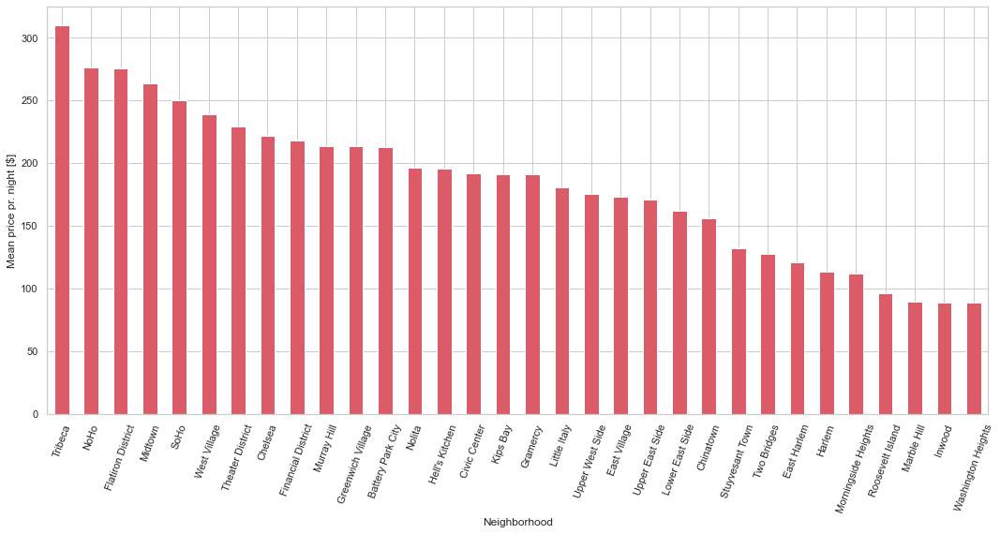

In [13]:
df_manhattan_price = df_manhattan[df_manhattan['price']<1000].groupby('neighbourhood').mean()
fig, ax = plt.subplots(figsize=(18,8))
(df_manhattan_price.sort_values(by = 'price', ascending = False))['price'].plot(kind = 'bar', ax = ax, rot = 70, color = colors[3])
ax.set_ylabel('Mean price pr. night [$]')
ax.set_xlabel('Neighborhood')
plt.show()

We see that Tribeca is quite in front in mean price followed by NoHo, Flatiron District and Midtown. Later we will look into the spatial influence on the price, but first will look into rental types, availability, reviews and introduce the other data sets that we will use for the analysis. 




We study the avg. price pr. night across the three different room types in an interactive plot with Bokeh. We first use group by on 'room_type' and 'neighborhood' and then we convert the dataframe into the required format for Bokeh. Some neighborhoods have no shared rooms, hence we have to manually add a row with this information.

In [14]:
## Computing the avg. price pr. room type for all neighborhoods
df_manhattan_avgprice = df_manhattan[['neighbourhood', 'room_type','price']]
df_add = pd.DataFrame([['Civic center', 'Shared room', 0], ['Flatiron District', 'Shared room', 0],['Marble Hill', 'Shared room', 0], 
                       ['NoHo', 'Shared room', 0], ['Tribeca', 'Shared room', 0], ['Two Bridges', 'Shared room', 0]], columns= ['neighbourhood', 'room_type', 'price'])

df_manhattan_avgprice = df_manhattan_avgprice.append(df_add, ignore_index=True)
df_manhattan_avgprice = df_manhattan_avgprice.groupby(['room_type', 'neighbourhood']).mean()

In [15]:
## Reformatting
df_plot = pd.DataFrame()
room_type = ['Entire home/apt', 'Private room', 'Shared room']

for i in room_type:
    df_plot[i] = np.ravel(df_manhattan_avgprice.loc[i].values)
    
df_plot['district'] = ['Battery Park City', 'Chelsea', 'Chinatown', 'Civic Center',
       'East Harlem', 'East Village', 'Financial District',
       'Flatiron District', 'Gramercy', 'Greenwich Village', 'Harlem',
       "Hell's Kitchen", 'Inwood', 'Kips Bay', 'Little Italy',
       'Lower East Side', 'Marble Hill', 'Midtown', 'Morningside Heights',
       'Murray Hill', 'NoHo', 'Nolita', 'Roosevelt Island', 'SoHo',
       'Stuyvesant Town', 'Theater District', 'Tribeca', 'Two Bridges',
       'Upper East Side', 'Upper West Side', 'Washington Heights',
       'West Village']

The cell below produces the plot. We will not split it further for additional explanation.

In [16]:
cols = ['firebrick', 'mediumblue', 'gold']

room_type = ['Entire home/apt', 'Private room', 'Shared room']
source = ColumnDataSource(df_plot)

dist = (np.array(['Battery Park City', 'Chelsea', 'Chinatown', 'Civic Center',
       'East Harlem', 'East Village', 'Financial District',
       'Flatiron District', 'Gramercy', 'Greenwich Village', 'Harlem',
       "Hell's Kitchen", 'Inwood', 'Kips Bay', 'Little Italy',
       'Lower East Side', 'Marble Hill', 'Midtown', 'Morningside Heights',
       'Murray Hill', 'NoHo', 'Nolita', 'Roosevelt Island', 'SoHo',
       'Stuyvesant Town', 'Theater District', 'Tribeca', 'Two Bridges',
       'Upper East Side', 'Upper West Side', 'Washington Heights',
       'West Village'])).tolist()

p = figure(plot_height=450, plot_width=900, x_range = dist, title = 'Avg. price for room types for all neighbourhoods')
p.xaxis.axis_label = "Neighbourhood"
p.yaxis.axis_label = "Avg. price pr. night"

bar ={}
for indx, i , color in zip(np.arange(len(room_type)), room_type, cols):
    bar[i] = p.vbar(x='district', top=i, source=source,  
                    muted_alpha=0.02, width = 0.5, alpha = 0.7, color = color)
    
items = []
for indx, i in enumerate(room_type):
    items.append((i, [bar[i]]))


legend = Legend(items=items, location=(5, 0))  
p.add_layout(legend, 'right')
p.legend.click_policy="mute" 
p.xaxis.major_label_orientation = math.pi/3
show(p)

Interesting points here is that Tribeca still has the most expensive Entire home/apt, but the private rooms of Midtown and West Village are more expensive. With relative few listings in the Financial District the average price of a shared room is almost as much as an entire home/apt. This is unlikely and probably rather due to one a two shared rooms skewing the prices. There is lots of more information - tinker with it yourself! 

As a final step in the the non-spatial exploration of the Airbnb dataset, we will take a look at reviews. Reviews are always a good indicator of an Airbnb and probably one of the first things we look at when we have found a potential vacation home. We will make a boxplot of number of reviews for some of the neighborhoods with most listings.

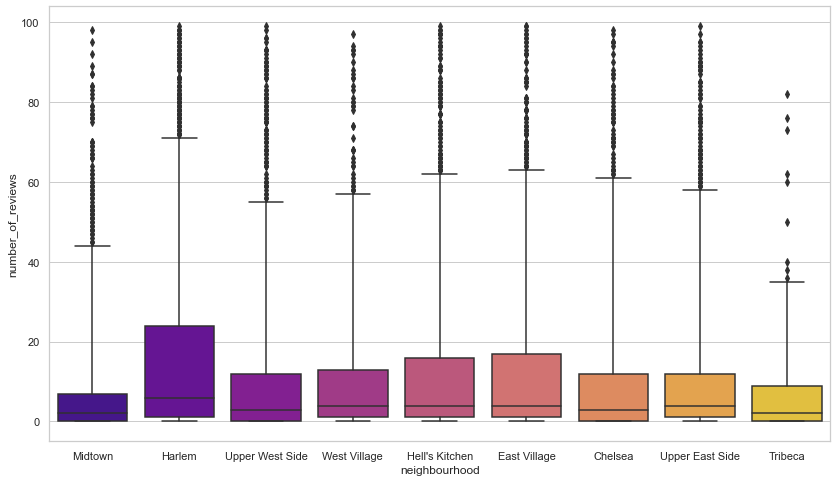

In [17]:
most_listings = ['Harlem', 'Upper West Side', 'Hell\'s Kitchen', 'East Village', 'Upper East Side', 'Chelsea', 'West Village', 'Midtown', 'Tribeca']
df_small = df_manhattan[df_manhattan.neighbourhood.isin(most_listings)]

fig, ax = plt.subplots(figsize=(14, 8))
b2 = sns.boxplot(ax = ax, data = df_small[df_small['number_of_reviews']<100], x="neighbourhood", y="number_of_reviews", 
                 palette = 'plasma', whis=[5, 95])

We have the whiskers to represent the 5% and 95% percentiles meaning that inside the whiskers, 95% of the data lies. While the median is quite close to each other across neighborhoods, we can see a big difference in inner quantiles and 95% quantile. As it is generally good to read reviews before choosing where you want to stay, one can look for hosts in especially Harlem and also East Village/Hells Kitchen as there is a good chance that will have more reviews. Beware that many reviews can also be an indicator that a place is horrible. Keep that in mind and remember to read the reviews!  

Some hosts have several listings which are usually designed to be rented out and rarely used privately. They can be a good starting point, if you are looking for Airbnbs that have a hotel-feeling to them. Lets try to see what hosts have the most listings in Manhattan.

In [18]:
## Identifying hosts with 10 most listings in Manhattan
top_host=df_manhattan.host_id.value_counts().head(10)
host_df = df_manhattan.set_index('host_id')
top_host_df=pd.DataFrame(top_host)

## Returning their rows from the original dataframe
top_host_count = host_df.loc[top_host.index]
top_host_df['name'] = host_df.loc[top_host.index].host_name.unique()

## Calculating mean price from hosts
mean_price = top_host_count.groupby('host_id').mean()
top_host_df['mean_price'] = mean_price['price']
top_host_df = top_host_df.set_index('name', drop = 'False')


We'll visualize the total listings of top host alongside the mean price pr. night. 

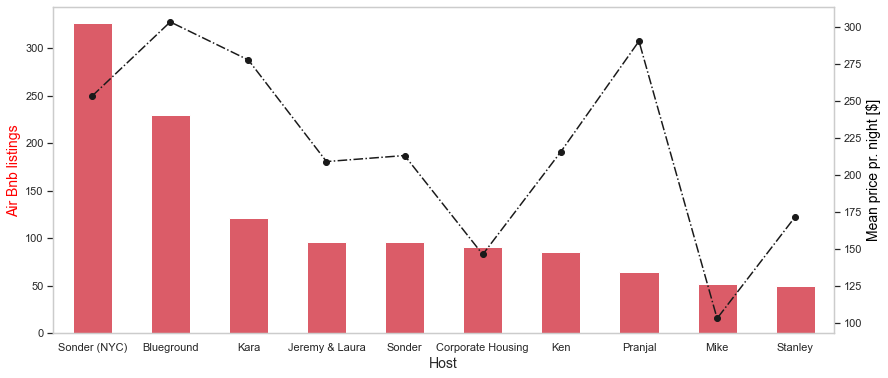

In [19]:
fig, ax = plt.subplots(figsize=(14,6))
top_host_df['host_id'].plot(kind = 'bar', ax = ax, rot = 0, color=colors[3])
ax.set_xlabel('Host', fontsize=14)
ax.set_ylabel('Air Bnb listings', color = 'red', fontsize=14)
ax2=ax.twinx()
ax2.plot(top_host_df['mean_price'], 'ko-.')
ax2.set_ylabel("Mean price pr. night [$]", color="black", fontsize=14)
ax.grid(False)
ax2.grid(False)
plt.show()

If you are looking for a cheaper place to stay, listings by Mike might be a good place to stay. For luxury, look to Blueground or Pranjal.

Now we will take a quick look at the other data sets which we would like to include in order for us to choose the optimal AirBnb. The data sets contain crime incidents, noise complaints and cafes/restaurants. From our travel experiences, these attributes can have a significant effect on the holiday. We also suspect that it can have an effect on the price of an AirBnb. 

Below we load in the data sets can pass them neighborhood names as the original ones did not have that attribute. These neighborhood names differ slightly from the ones in the AirBnb data set. Apparently, partioning Manhattan into neighborhoods can be done in many ways and there is no clear number of neighborhoods. The shp-file including neighborhoods that we found contains fewer neighborhoods than in the AirBnb data set. To cope with this we merge some neighborhoods into one to get a total of 20 neighborhoods instead of 32.

In [20]:
neighborhood_names = list(nil['NTAName'])
neighborhoods = ['washingtonheights', 'uppereastside', 'upperwestside', 'eastharlem', 'harlem', 'midtown', 'hellskitchen',
                'financial', 'morningheights', 'chelsea', 'westvillage', 'eastvillage', 'lowereast', 'murrayhill',
                'morningheights', 'rooseveltisland', 'soho', 'chinatown', 'gramercy', 'stuyvesant']
num_cafe = []
num_crime = []
num_noise = []
cafes_df = pd.DataFrame()
crimes_df = pd.DataFrame()
noise_df = pd.DataFrame()
for i in range(len(neighborhoods)):
    place = neighborhoods[i]
    nca = pd.read_csv('crime/cafes_' + str(place) + '.csv', encoding= 'unicode_escape')
    ncr = pd.read_csv('crime/crimes_' + place + '.csv')
    nno = pd.read_csv('crime/noise_' + place + '.csv')
    nca['neighbourhood'] = neighborhood_names[i]
    ncr['neighbourhood'] = neighborhood_names[i]
    nno['neighbourhood'] = neighborhood_names[i]
    
    cafes_df = cafes_df.append(nca)
    crimes_df = crimes_df.append(ncr)
    noise_df = noise_df.append(nno)
    
    num_cafe.append(len(nca))
    num_crime.append(len(ncr))
    num_noise.append(len(nno))

Below we show how many cafes/restaurants, crime incidents and noise complaints there are across the neighbourhoods.

In [21]:
## Couting numbers pr. neighbourhood
df_manhattan_cafe = cafes_df.groupby('neighbourhood').count()
df_manhattan_crime = crimes_df.groupby('neighbourhood').count()
df_manhattan_noise = noise_df.groupby('neighbourhood').count()

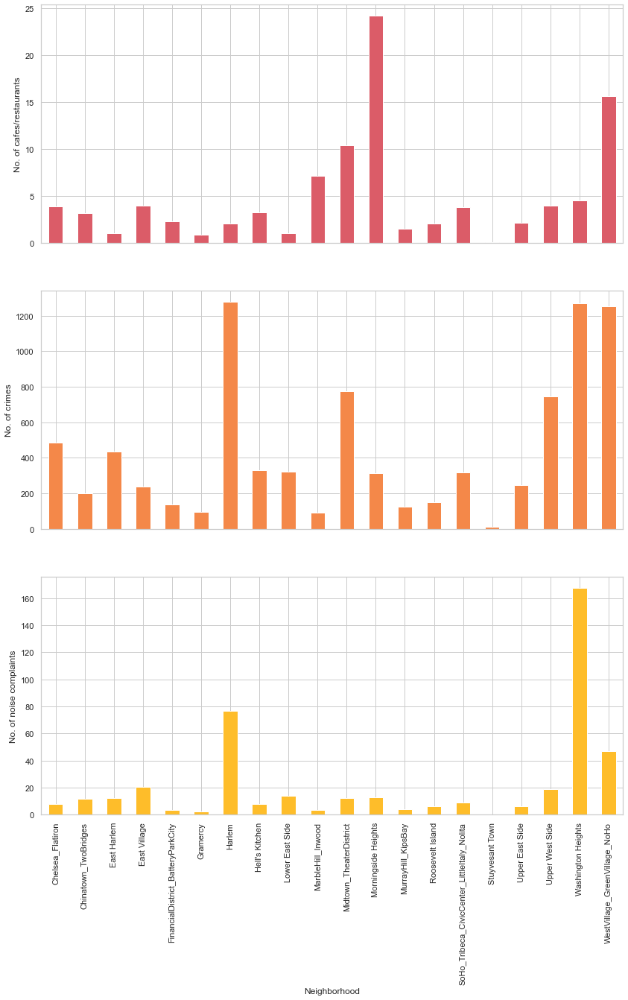

In [22]:
## Visualizing
fig, ax = plt.subplots(3,1,figsize=(14,20), sharex=True)
(df_manhattan_cafe['CAMIS']/nil['Shape_Area'].values*1e5).plot(kind = 'bar', ax = ax[0], rot = 90, color = colors[3])
ax[0].set_ylabel('No. of cafes/restaurants')
(df_manhattan_crime['field_1']/nil['Shape_Area'].values*1e5).plot(kind = 'bar', ax = ax[1], rot = 70, color = colors[4])
ax[1].set_ylabel('No. of crimes')
(df_manhattan_noise['Incident Zip']/nil['Shape_Area'].values*1e5).plot(kind = 'bar', ax = ax[2], rot = 90, color = colors[5])
ax[2].set(xlabel='Neighborhood',ylabel='No. of noise complaints')
plt.show()

Midtown and Theater District share a great amount of cafes and restaurants while Stuvesant Town, Financial District and Battery Park City have very few according to our data set. Harlem and Washington Heights peak in both crime and noise complaints making it a perfect place for the adventures. East Village seems like a good place for the traveller who likes going out to eat, but doesn't fancy getting robbed in the process. This is in accordance with what we can find of information on the neighborhoods. No noise complaints were filed in Stuyvesant Town (!), hence it could be an ideal neighborhood if one appreciates silence

We can gather some of the key information obtained from the analysis above in a spatial map partioned by neighborhood in chloropath-style. To this end, we use the folium-package to display the shp-file with the neighborhoods in a open street view map. We have added the key characteristics to the shp-file in QGIS as it we couldn't figure out how to do it in Python. Hover over the neighborhoods to reveal some key characteristics!

In [23]:
## Creating basemap with the color grading dependent on price
mymap = folium.Map(location=[40.7788, -73.9660], zoom_start=12,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap)
myscale = (nil['Avg_Price'].quantile((0,0.15,0.30,0.45,0.60,0.85, 1))).tolist()
mymap.choropleth(
 geo_data=nil,
 name='Choropleth',
 data=nil,
 columns=['NTAName','Avg_Price'],
 key_on="feature.properties.NTAName",
 fill_color='YlGnBu',
 threshold_scale=myscale,
 fill_opacity=1,
 line_opacity=0.2,
 legend_name='Average rent price pr. night [$]',
 smooth_factor=0
)
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

In [24]:
## Adding the pop-up
NIL = folium.features.GeoJson(
    nil,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NTAName','Avg_Price', 'Density', 'crime_day', 'noise_dens', 'cafe_dens'],
        aliases=['Neighborhood: ','Average price pr. night [$]: ', 'Air bnb pr. km2: ', 'Crime incident pr. year pr. km2: ',
                'Noise complaints pr. km2: ', 'Cafes pr. km2: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
mymap.add_child(NIL)
mymap.keep_in_front(NIL)
folium.LayerControl().add_to(mymap)
mymap

The values can be a bit confusing as we have divided by the area of the neighborhood, but we deemed it more saying when it is given relative to size. Population could also be interesting, but that data was no available for all neighborhoods. It is clear that the more expensive neighborhoods are found South of Central Park. It appears that there are quite a few cheap options around Roosevelt Island, Washington Heights, Marble Hill an Inwood.

The previous map is great for creating an overview of the different neighborhoods. In the following plot we show the individual AirBnbs as they are spread out through Manhattan. Again, we will not go through all the code, but just have few comments. Zoom in on the map to separate individual listings from the clusters and left-click to reveal name and price. 

In [25]:
lats = list(df_manhattan.latitude)
lons = list(df_manhattan.longitude)

df_manhattan['name_and_price'] = df_manhattan['name'] + ' Price pr. night ' + df_manhattan['price'].astype('str') + '$'

df_manhattan = df_manhattan.reset_index()
from folium.plugins import MarkerCluster
locationlist = list(zip(df_manhattan['latitude'], df_manhattan['longitude']))

map2 = folium.Map(location=[40.7788, -73.9660], tiles='CartoDB positron', zoom_start=12)

home_layer = folium.FeatureGroup(name="Enitre home/apt")
home_cluster = MarkerCluster().add_to(home_layer)

private_room_layer = folium.FeatureGroup(name="Private room")
private_room_cluster = MarkerCluster().add_to(private_room_layer)

shared_room_layer = folium.FeatureGroup(name="Shared room")
shared_room_cluster = MarkerCluster().add_to(shared_room_layer)


for point in range(0, len(locationlist)):
    if df_manhattan['room_type'][point] == 'Entire home/apt':
            #folium.CircleMarker(locationlist[point], popup = df_manhattan['name_and_price'][point], 
                                #fill = True, color = 'red').add_to(home_cluster)
            folium.Marker(popup = df_manhattan['name_and_price'][point], location = locationlist[point], icon=folium.Icon(color='red', icon='airbnb', prefix='fa')).add_to(home_cluster)



    if df_manhattan['room_type'][point] == 'Private room':
            folium.Marker(popup = df_manhattan['name_and_price'][point], location = locationlist[point], icon=folium.Icon(icon='airbnb', prefix='fa',color='blue')).add_to(private_room_cluster)

    if df_manhattan['room_type'][point] == 'Shared room':
            folium.Marker(popup = df_manhattan['name_and_price'][point], location = locationlist[point], icon=folium.Icon(icon='airbnb', prefix='fa', color='orange')).add_to(shared_room_cluster)
            
            
map2.add_child(home_layer)
map2.add_child(private_room_layer)
map2.add_child(shared_room_layer)

            
myscale = (nil['Avg_Price'].quantile((0,0.15,0.30,0.45,0.60,0.85, 1))).tolist()            
map2.choropleth(
 geo_data=nil,
 name='Neighbourhood overview',
 data=nil,
 columns=['NTAName','Avg_Price'],
 key_on="feature.properties.NTAName",
 fill_color='YlGnBu',
 threshold_scale=myscale,
 fill_opacity=0.6,
 line_opacity=1,
 legend_name='Average rent price pr. night',
 smooth_factor=0
)
#folium.LayerControl().add_to(map2)
map2.add_child(folium.map.LayerControl())

#map2.save("mapcluster_final1.html")

map2

There are many other key characteristcs that could be added to thus as with the neighbourhood map i.e. museums, art galleries, parks etc. We would also like to add a predicted price to the map above, so one can judge whether the Airbnb is too expensive or not. To this end, we will move onto the modelling. 

### 3. Data analysis (modelling)

In the explorative analysis we have learned a lot about the data sets in question. As students, the ideal vacation is fun, but also cheap. We would like to investigate whether we are able to predict the prices of the listings based on the other attributes from the AirBnb data set. Then, we will add the crime, cafe/restaurant and noise information to asses if the model improves. The idea is that we will be able to determine whether an Airbnb is overpriced or not.

We consider the columns 'id', 'name', 'host_id', 'host_name','last_review', 'calculated_host_listings_count' for having no influence on the price and irrelevant for the purpose of predicting AirBnb. To reduce unnecessary complexity we'll drop these columns.

In [26]:
modelling_df = df_manhattan.copy()
modelling_df.drop(
    columns=["neighbourhood_group","id", "name", "host_id", "host_name", "last_review", "name_and_price"],
    inplace = True)

For machine learning purpose, data have to be understandable to any machine learning model, and all categorical data have to be encoded. This contains the columns 'neighbourhood_group' and 'room_type'. As there is no ordinality in these categories, these have to be encoded. Encoding depends on the choice of ML model - tree based models are in general indifferent of one-hot encoding or label encoding

In [27]:
modelling_df['neighbourhood'] = modelling_df['neighbourhood'].astype('category').cat.codes
modelling_df['room_type'] = modelling_df['room_type'].astype('category').cat.codes

##Move 'price' to last column
price_col = modelling_df.pop('price')
modelling_df.insert(len(modelling_df.columns), 'price', price_col)

modelling_df.head()

,index,neighbourhood,latitude,longitude,room_type,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price
0,1,17,40.75362,-73.98377,0,1,45,0.38,2,355,225
1,2,10,40.80902,-73.94190,1,3,0,0.00,1,365,150
2,4,4,40.79851,-73.94399,0,10,9,0.10,1,0,80
3,5,19,40.74767,-73.97500,0,3,74,0.59,1,129,200
4,7,11,40.76489,-73.98493,1,2,430,3.47,1,220,79


We'll inspect the correlation among the input and output variables. A nice and quick method to do this is through a correlation heatmap which can be calculated with pandas and displayed with seaborn.

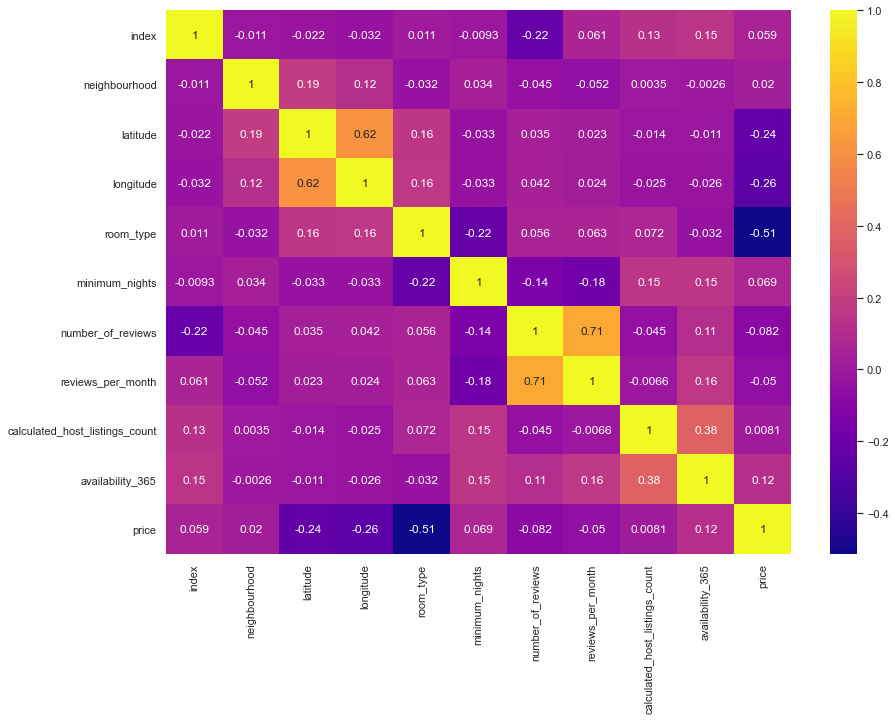

In [28]:
corr = modelling_df.corr(method='kendall')

fig, ax = plt.subplots(figsize=(14, 10))
b2 = sns.heatmap(ax = ax, data=corr, annot=True, cmap = 'plasma')

The most important thing to note is that mainly latitude, longitude and room type that is most correlated to the price. There are other interesting things to note here, but in the interest of keeping the notebook relatively short, we will not comment on this.

We will use random forest regression to predict the prices. We will split the data set into 70% and 30% and shuffle the data. Random forest requires no standardization of the input data. As we saw earlier, there were a few AirBnb's that are very expensive. For that reason, we will set an upper limit on the price to be 500\\$ in an attempt to improve the model.

In [29]:
X, y = modelling_df[modelling_df.price<=500].iloc[:,:-1], modelling_df[modelling_df.price<=500].iloc[:,-1]
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=.3, random_state=50)

Initially, the model initially with 100 estimators meaning that we include 100 trees in the forest where we choose the tree that performs the best. We will give a maximum depth of 20 and impose that to be a leaf node, it must contain 8 samples. We use the sklearn-framework to perform training and prediction. To asses the performance of the models we use the root mean square error (RMSE). We also calculate the coefficient of determination between the actual and predicted prices.

In [30]:
rf = RandomForestRegressor(n_estimators=125, min_samples_leaf=8, max_depth=16, random_state = 40)
rf.fit(X_train, y_train)
y_predTrain = rf.predict(X_train)
y_pred = rf.predict(X_test)
print("RMSE prediction on train = {:0.5f}.".format((np.sqrt(mean_squared_error(y_predTrain, y_train)))))
print("R2 Score prediciton on train = {:0.5f}.".format(r2_score(y_train,y_predTrain)))

print("\nRMSE prediction on test = {:0.5f}.".format(np.sqrt(mean_squared_error(y_pred, y_test))))
print("R2 Score prediciton on test = {:0.5f}.".format(r2_score(y_test,y_pred)))

RMSE prediction on train = 54.62094.
R2 Score prediciton on train = 0.67064.

RMSE prediction on test = 67.57364.
R2 Score prediciton on test = 0.49365.


We see that the model performs significantly better on the training data. The RMSE for the test data is 67.57 and the R2 score is 0.49. The RMSE scores are rather high indicating that the predicted prices are quite farm from the actual prices. The R2 is quite low indicating that we can explain 49% of the variance in the actual prices through the predicted prices which is quite low. 

We can try to use random grid search to calculate the optimal hyperparameters on the training data. We use randomized grid search which is also a part of the sk-learn package (CITE). 

In [31]:
n_estimators = [int(x) for x in np.linspace(start = 50, stop = 150, num = 10)]
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 25, num = 5)]
max_depth.append(None)
# Samples required at each leaf node
min_samples_leaf = [1, 2, 4]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_leaf': min_samples_leaf}

In [32]:
rf_opt = RandomForestRegressor(random_state = 40)
rf_random = RandomizedSearchCV(estimator = rf_opt, param_distributions = random_grid, n_iter = 50, 
                               cv = 3, verbose=2, random_state=42, n_jobs = -1)
rf_random.fit(X_train, y_train)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   28.4s
[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  2.3min finished


RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(random_state=40),
                   n_iter=50, n_jobs=-1,
                   param_distributions={'max_depth': [10, 13, 17, 21, 25, None],
                                        'min_samples_leaf': [1, 2, 4],
                                        'n_estimators': [50, 61, 72, 83, 94,
                                                         105, 116, 127, 138,
                                                         150]},
                   random_state=42, verbose=2)

The optimal parameters are the following:

In [33]:
print(rf_random.best_params_)

{'n_estimators': 105, 'min_samples_leaf': 2, 'max_depth': 13}


Let's try to see how the model performs on the optimal parameters

In [34]:
best_hype = rf_random.best_estimator_
y_predTrain = best_hype.predict(X_train)
y_pred = best_hype.predict(X_test)
print("RMSE prediction on train = {:0.5f}.".format((np.sqrt(mean_squared_error(y_predTrain, y_train)))))
print("R2 Score prediciton on train = {:0.5f}.".format(r2_score(y_train,y_predTrain)))

print("\nRMSE prediction on test = {:0.5f}.".format(np.sqrt(mean_squared_error(y_pred, y_test))))
print("R2 Score prediciton on test = {:0.5f}.".format(r2_score(y_test,y_pred)))

RMSE prediction on train = 47.92575.
R2 Score prediciton on train = 0.74643.

RMSE prediction on test = 67.63175.
R2 Score prediciton on test = 0.49278.


We can see that the model performs slightly better:

In [35]:
print('Improvement of {:0.2f}%.'.format( 100 * (67.63175 - 67.57363928877321) / 67.57363928877321))

Improvement of 0.09%.


We can visualize the predicted prices vs. the actual prices below:

[]

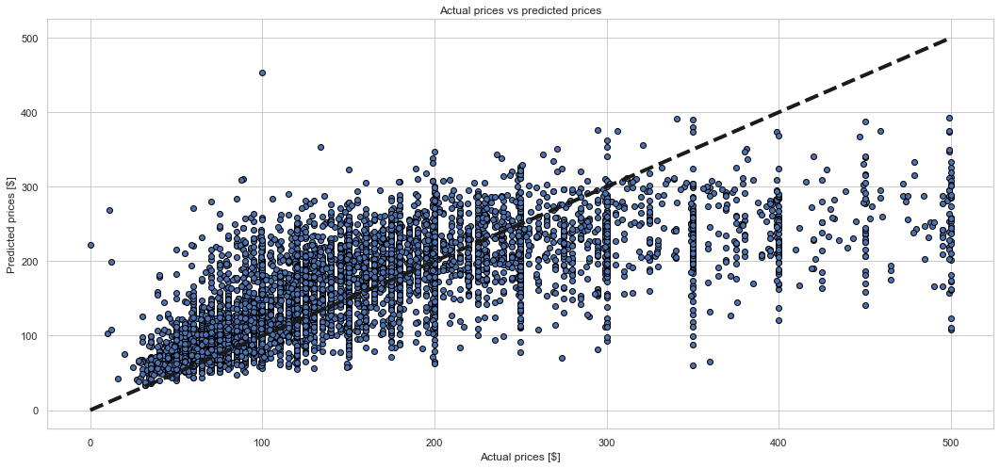

In [36]:
fig, ax = plt.subplots(figsize=(18,8))
ax.scatter(y_test, y_pred, edgecolors=(0, 0, 0))
ax.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=4)
ax.set_xlabel('Actual prices [$]')
ax.set_ylabel('Predicted prices [$]')
ax.set_title("Actual prices vs predicted prices")
plt.plot()

We see that their is a slight pattern, but the points are still very scattered around the straight line indicating that the predicted prices are quite far off. Let's see if adding information about the neighborhoods helps the model!

#### Adding crime, cafes/restaurant and noise complaint data 

To this end we will have to add a new neighborhood-variable containing the merged neighborhoods of the other data sets. First, we create a copy of the data frame we have been using so far and call the new column 'district'

In [37]:
merged_df = df_manhattan.copy()
merged_df['district'] = merged_df['neighbourhood']

We will give them the appropriate names depending on value in 'neighbourhood'

In [38]:
merged_df['district'] = ['FinancialDistrict_BatteryParkCity' if x == 'Financial District' or x == 'Battery Park City' else x for x in merged_df['district']]
merged_df['district'] = ['SoHo_Tribeca_CivicCenter_LittleItaly_Nolita' if x == 'SoHo' or x == 'Tribeca' or x == 'Civic Center' or x == 'Little Italy' or x == 'Nolita' else x for x in merged_df['district']]
merged_df['district'] = ['Chelsea_Flatiron' if x == 'Chelsea' or x == 'Flatiron District' else x for x in merged_df['district']]
merged_df['district'] = ['MurrayHill_KipsBay' if x == 'Murray Hill' or x == 'Kips Bay' else x for x in merged_df['district']]
merged_df['district'] = ['MarbleHill_Inwood' if x == 'Marble Hill' or x == 'Inwood' else x for x in merged_df['district']]
merged_df['district'] = ['Midtown_TheaterDistrict' if x == 'Midtown' or x == 'Theater District' else x for x in merged_df['district']]
merged_df['district'] = ['WestVillage_GreenVillage_NoHo' if x == 'West Village' or x == 'Greenwich Village' or x == 'NoHo' else x for x in merged_df['district']]
merged_df['district'] = ['Chinatown_TwoBridges' if x == 'Chinatown' or x == 'Two Bridges' else x for x in merged_df['district']]

Now we will add the information from the other data sets into the Airbnb data set by looking up the neighborhood name

In [39]:
k = 0
for i in neighborhood_names:
    merged_df.loc[(merged_df['district'] == i),'cafes/rest'] = num_cafe[k]
    merged_df.loc[(merged_df['district'] == i),'noise'] = num_crime[k]
    merged_df.loc[(merged_df['district'] == i),'crime'] = num_noise[k]
    k+=1


Now, with the new data frame we can run the forest regression model that we obtaiend from the hyperparameter tuning again. It would probably benefit from optimizing again, but it is probably not necessary seeing the small improvement we gained from tuning before. 


In [40]:
## Dropping valuables and preparing variables
modelling_df2 = df_manhattan.copy()
modelling_df2.drop(
    columns=["neighbourhood_group","id", "name", "host_id", "host_name", "last_review", "name_and_price"],
    inplace = True)
modelling_df2['neighbourhood'] = modelling_df2['neighbourhood'].astype('category').cat.codes
modelling_df2['room_type'] = modelling_df2['room_type'].astype('category').cat.codes

##Move 'price' to last column
price_col = modelling_df2.pop('price')
modelling_df2.insert(len(modelling_df2.columns), 'price', price_col)

## Preparing training and test set
X, y = modelling_df[modelling_df.price<=500].iloc[:,:-1], modelling_df[modelling_df.price<=500].iloc[:,-1]
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=.3, random_state=50)

## Making model
rf = RandomForestRegressor(n_estimators=125, min_samples_leaf=8, max_depth=16, random_state = 40)
rf.fit(X_train, y_train)
y_predTrain = rf.predict(X_train)
y_pred = rf.predict(X_test)
print("RMSE prediction on train = {:0.5f}.".format((np.sqrt(mean_squared_error(y_predTrain, y_train)))))
print("R2 Score prediciton on train = {:0.5f}.".format(r2_score(y_train,y_predTrain)))

print("\nRMSE prediction on test = {:0.5f}.".format(np.sqrt(mean_squared_error(y_pred, y_test))))
print("R2 Score prediciton on test = {:0.5f}.".format(r2_score(y_test,y_pred)))


RMSE prediction on train = 54.62094.
R2 Score prediciton on train = 0.67064.

RMSE prediction on test = 67.57364.
R2 Score prediciton on test = 0.49365.


The model does not improve at all.. We thought it would have a bigger influence on the prices, but there are probably many more factors that have an influence like size, rating, furniture, balcony etc, that are more important for the prize. Also, the information from the other data sets is only on given on neighbourhood scale, which is probably too imprecise to actually affect the price of the Airbnb. This could have been worked around by creating a fine grid and calculating mean values of the other data sets on these.

That rounds of the data analysis part. Now we will discuss the vizualisation techniques we have used in the website. 

# 4. Genre. Which genre of data story did you use?

Our aim is to explore the intersection of author- and reader-driven elements by enriching the ‘Magazine Style’ genre, mostly known for its static visualisations, with interactive visualisations that creates a multimedia story. To this end, we use the Annotated Map, as it is widely used for creating interactive maps. We develop a martini glass structure approach, where we first combine a text story with static images to support each other in creating an easy-to-read narrative that highlights certain points. We then change to a reader-driven stage, where the reader, now armed with all the facts, can use an interactive visualisation to explore the elements freely. 

![](martini.png)

**The introduction:** We let the user know that our story can help them understand where to live in Manhattan when travelling (and why).


**The body:** We highlight how prices, crime, noise and bars characterise each neighbourhood through text and static visualisations. We zoom down on a an interesting case: Tribeca.

**The conclusion:** An interactive map allows the reader to explore neighbourhoods.

### Tools used
From the **Visual Narrative** category, we have used Establishing shot for **Visual Structuring** and *Feature distinction*, *Zoom and Motion* for **Highlighting**.

Establishing shots is used as we present the map in the beginning of the story and the map immediately contains an overview of Manhattan and the neighb
ourhoods. Feature distinction is applied through colour scaling (although it doesn’t show the difference in features but rather the data scale in one feature) and as the user hovers her mouse over a neighbourhood, the different features appear. Zoom and motion is applied when clicking on a circle or when using the mouse to zoom in or out.

From the **Narrative Structure** category, we have used Linear for **Ordering** and Hover Highlighting, Very Limited **Interactivity**, Selection and Navigation Buttons for Interactivity. Lastly, we’ve used Caption / Headlines, Accompanying Article and Introductory text for **Messaging**.

The narrative structure follows a linear ordering, as we have used the martini glass structure and the user does not choose (user directed) or can choose a random direction (random). The interactive map uses Hover Highlighting as details appear when the mouse hovers over a neighbourhood and Navigation Buttons in the top right corner to shift between layers. For the sake of simplicity, we’ve used Very Limited Interactivity and features like filtering and search are therefore absent - however, users can select a neighbourhood to zoom in on what apartments were available. 

# 5. Visualizations

Our ambition has been to give an overview of the distribution and density of different characteristics segmented on neighbourhoods. To this end, histograms, bar charts, boxplots and violin plots are very effective as they provide an easy-to-understand format for comparing distributions. Lastly, the geographical map has been used to visualise geographical data.

* **Histograms** have been used to show frequency distributions when looking at numerical data.

* **Bar charts** have been used to show comparisons of categorical data.

* **Box plots** have been used to show the sample distribution across different categories in quartile groups to better understand the statistical distribution of data.

* **Violin plots** have been used to a similar end as box plots, but in situations where the density shape of the data has been interesting. Unlike boxplots violin plots can show this. 

* **Geographical map.** All datasets have been centred around geospatial data and with the ambition to show differences in neighbourhoods, the geographical map has been used as the final form of visualisation.

As our ambition hasn’t been to look at the relationship between features, we’ve chosen to avoid using scatter plots in telling our story.

# 6. Discussion and critism 
In this section we'll discuss the process - what went well, what didn't went so well and what we'd like to investigate further.

**What went well?**

* Combining genres and media to create a more user-centred storytelling, where static images and text support each other to create an easy-to-understand format and interactive visualisations enrich the functionality for the user. This mix makes the story usable for those who are looking for a quick overview as well as those, who want to do more of a deep dive into the story.


* Combining datasets have enabled us to highlight different features and create a more nuanced story. As travellers have a lot, and highly differentiated, preferences about where to live, we see the inclusion of several features (like safety, noise and pricing) to be a necessity.


* The spatial analysis. We are all quite satisfied with the result and visualizations from this although we had some challanges in finding an appropriate map of the neighbourhoods in Manhattan.

**The following points would be interesting to continue to work on:**

* More interactivity could have increased the usability. We especially believe that adding sliders, where users could insert their preferences and find neighbourhoods with the best match, could be a really interesting feature as it would allow users to quickly navigate through the map.


* Adding more features, like density of nature, type culinary scene and cultural events, would make the overview more interesting to users so that they could quickly circle down on where and why they wanted to stay in a given neighborhood.

**What did not went so well?**

* Although the AirBnB data is quite informative, we might missed other relevant features in the context of our story - for example a feature of AirBnB ratings, condition etc. could have been a great feature to include into our data analysis to help tourist find the perfect rental.


* The machine learning part did not yield satisfying models and results. This might be linked to the missing features that might also have a huge influence on the price of AirBnB rental.

# 7. Contributions. Who did what?

#### Responsibilities:
* **Mik:** Story building, part 1, 4, 5, 6. 
* **Julian:** Collecting the notebook, machine learning, data preprocessing, spatial analysis.
* **Julie:** General visualizations, builing the website, machine learning.

# 8. References

 1\. Kaggle, New York City Airbnb Open Data 2019
https://www.kaggle.com/dgomonov/new-york-city-airbnb-open-data

2\. Kaggle, Noise Complaints in New York
https://www.kaggle.com/somesnm/partynyc 

3\. City Of New York, Restaurants Inspections
https://data.cityofnewyork.us/Health/DOHMH-New-York-City-Restaurant-Inspection-Results/rs6k-p7g6

4\. Kaggle, New York Crime History
https://www.kaggle.com/mrmorj/new-york-city-police-crime-data-historic 

5\. The Global Guide, Basic Information
https://www.nycgo.com/plan-your-trip/basic-information

6\. Mode, The Violin Plot 101
https://mode.com/blog/violin-plot-examples/

7\. scikit-learn, Machine Learning in Python
https://scikit-learn.org/stable/

8\. Edward Segel and Jeffrey Heer,  Narrative Visualization: Telling Stories with Data

9\. Joel Grus, Data Science from Scratch